De esta ecuaciión podemos hacer un despeje para encontrar las tres ecuaciones diferenciales que modelan nuestra neurona.
\begin{equation}
I=C_{m} \frac{\mathrm{d} V}{\mathrm{d} T}+\bar{g_{Na}}m^{3}_{1}h^{1}_{1}(V-50)+\bar{g_{CaT}}m^{3}_{2}h^{1}_{2}(V-0)+\bar{g_{CaS}}m^{3}_{3}h^{1}_{3}(V-0)+\bar{g_{A}}m^{3}_{4}h^{1}_{4}(V+80)+\bar{g_{KCa}}m^{4}_{5}
(V+80)+\bar{g_{Kd}}m^{4}_{6}(V+80)+\bar{g_{H}}m^{1}_{7}(V+20)+0.01(V+50)
\end{equation}

Por tanto podemos encontrar el sistema de ecuaciones con el cual trabajaremos. 
\begin{equation}
\frac{\mathrm{d} V}{\mathrm{d} T} =\frac{1}{C} (I -(\bar{g_{Na}}m^{3}_{1}h^{1}_{1}(V-50)+\bar{g_{CaT}}m^{3}_{2}h^{1}_{2}(V-0)+\bar{g_{CaS}}m^{3}_{3}h^{1}_{3}(V-0)+\bar{g_{A}}m^{3}_{4}h^{1}_{4}(V+80)+\bar{g_{KCa}}m^{4}_{5}
(V+80)+\bar{g_{Kd}}m^{4}_{6}(V+80)+\bar{g_{H}}m^{1}_{7}(V+20)+0.01(V+50)))
\end{equation}

\begin{equation}
\tau_{m_{i}} \frac{\mathrm{d} m_{i}}{\mathrm{d} t}=m_{\propto_{i} }-m_{i}
\end{equation}

\begin{equation}
\tau_{h_{i}} \frac{\mathrm{d} h}{\mathrm{d} t}=h_{\propto_{i}}-h_{i}
\end{equation}

donde algunos parametros importantes vienen dados por esta tabla

<img src="alesio.png">

ademas la concentracion de calcio usado para controlar $I_{Ca}$ esta determinada por 
\begin{equation}
(20milisec)\frac{\mathrm{d} [Ca^{2+}]}{\mathrm{d} t}=-0.94(I_{Ca})-[Ca^{2+}]+0.05
\end{equation}

In [3]:
#importamos las bibliotecas a usar
using Plots

In [4]:
#creamos las funciones necesarias para construir el sistema de ecuaciones
boltz(V::Float64,A::Float64,B::Float64)= 1/(1 + exp((V+A)/B))
tauX(V::Float64,A::Float64,B::Float64,D::Float64,E::Float64)= A - (B*boltz(V,D,E))
minf1(V::Float64) = boltz(V,25.5,-5.29)
taum1(V::Float64) = tauX(V,1.32,1.26,120.,-25.)
hinf1(V::Float64) = boltz(V,48.9,5.18)
tauh1(V::Float64) = (0.67/(1+exp((V+62.9)/-10.0)))*(1.5 + 1/(1+exp((V+34.9)/3.6)))
minf2(V::Float64) = boltz(V,27.1,-7.2)
taum2(V::Float64) = tauX(V,21.7,21.3,68.1,-20.5)
hinf2(V::Float64) = boltz(V,32.1,5.5)
tauh2(V::Float64) = tauX(V,105.,89.8,55.,-16.9)
minf3(V::Float64) = boltz(V,33.,-8.1)
taum3(V::Float64) = (1.4 + (7/((exp((V+27)/10))+(exp((V+70)/-13)))))
hinf3(V::Float64) = boltz(V,60.,6.2)
tauh3(V::Float64) = 60 + (150/((exp((V+55)/9))+(exp((V+65)/-16))))
minf4(V::Float64) = boltz(V,27.2,-8.7)
taum4(V::Float64) = tauX(V,11.6,10.4,32.9,-15.2)
hinf4(V::Float64) = boltz(V,56.9,4.9)
tauh4(V::Float64) = tauX(V,38.6,29.2,38.9,-26.5)
taum5(V::Float64) = tauX(V,90.3,75.1,46.,-22.7)
minf6(V::Float64) = boltz(V,12.3,-11.8)
taum6(V::Float64) = tauX(V,7.2,6.4,28.3,-19.2)
minf7(V::Float64) = boltz(V,70.,6.)
taum7(V::Float64) = tauX(V,272.,-1499.,42.2,-8.73)
minf5(V::Float64,Ca::Float64) = (Ca/(Ca+3))*(1/(1+exp((V+28.3)/-12.6)))

minf5 (generic function with 1 method)

### Aquí tenemos el primer modelo basado en el método de euler para dar solución al sistema de ecuaciones

In [5]:
######
const ENa=50.
const ECa=100.
const EK=-80.
const EH=-20.
const EL=-5.  
const C=1.

######
## h es el paso generalmente se construye a travez de b-a/2
## t va a ser el tiempo 
## p son parametros iniciales
## r son las condiciones inciales 


function stgjafet(h,t,p,r)
   
    #########################
    tiempo=1:t
    tiempo2=length(tiempo)/100
    #########################
    Vpoints=zeros(convert(Int64,tiempo2))
    Ca2points=zeros(convert(Int64,tiempo2))
    gNapoints=zeros(convert(Int64,tiempo2))
    gCaTpoints=zeros(convert(Int64,tiempo2))
    gCaSpoints=zeros(convert(Int64,tiempo2))
    gApoints=zeros(convert(Int64,tiempo2))
    gKCapoints=zeros(convert(Int64,tiempo2))
    gKdpoints=zeros(convert(Int64,tiempo2))
    gHpoints=zeros(convert(Int64,tiempo2))
    ###########################
    I=p[1]
    taugg=p[2]
    taumm=p[3]
    gtgtNa=p[4]
    gtgtCaT=p[5]
    gtgtCaS=p[6]
    gtgtA=p[7]
    gtgtKCa=p[8]
    gtgtKd=p[9]
    gtgtH=p[10]
    catgt=p[11]
    gL=p[12]
    ##########################
    #(V,Ca,m1,m2,m3,m4,m5,m6,m7,h1,h2,h3,h4,g1,g2,g3,g4,g5,g6,g7,mg1,mg2,mg3,mg4,mg5,mg6,mg7)
    #condiciones iniciales
    Vpoints[1]=V=r[1]
    Ca2points[1]=Ca2=r[2]
    mNa=minf1(V)
    mCaT=minf2(V)
    mCaS=minf3(V)
    mA=minf4(V)
    mKCa=minf5(V,Ca2)
    mKd=minf6(V)
    mH=minf7(V)
    hNa=hinf1(V)
    hCaT=hinf2(V)
    hCaS=hinf3(V)
    hA=hinf4(V)
    gNapoints[1]=gNa=r[3]
    gCaTpoints[1]=gCaT=r[4]
    gCaSpoints[1]=gCaS=r[5]
    gApoints[1]=gA=r[6]
    gKCapoints[1]=gKCa=r[7]
    gKdpoints[1]=gKd=r[8]
    gHpoints[1]=gH=r[9]
    mgNa=gNa
    mgCaT=gCaT
    mgCaS=gCaS
    mgA=gA
    mgKCa=gKCa
    mgKd=gKd
    mgH=gH
    ##########################
    for i=2:length(tiempo)
    
        V += h* 1/C * ( I -(gNa*mNa^3*hNa*(V-ENa)+gCaT*mCaT^3*hCaT*(V-ECa)+gCaS*mCaS^3*hCaS*(V-ECa)
                +gA*mA^3*hA*(V-EK)+gKCa*mKCa^4*(V-EK)+gKd*mKd^4*(V-EK)+gH*mH*(V-EH)+gL*(V-EL)))
        
        Ca2 += h*(-0.94*(gCaT*mCaT^3*hCaT*(V-ECa)+gCaS*mCaS^3*hCaS*(V-ECa))-Ca2+0.05)
        
        mNa+= h/taum1(V)*(minf1(V)-mNa)
        mCaT+= h/taum2(V)*(minf2(V)-mCaT)
        mCaS+= h/taum3(V)*(minf3(V)-mCaS)
        mA+= h/taum4(V)*(minf4(V)-mA)
        mKCa+= h/taum5(V)*(minf5(V,Ca2)-mKCa)
        mKd+= h/taum6(V)*(minf6(V)-mKd)
        mH+= h/taum7(V)*(minf7(V)-mH)
        
        hNa += h/tauh1(V)*(hinf1(V)-hNa)
        hCaT += h/tauh2(V)*(hinf2(V)-hCaT)
        hCaS += h/tauh3(V)*(hinf3(V)-hCaS)
        hA += h/tauh4(V)*(hinf4(V)-hA)
        
        gNa += h/taugg*(mgNa-gNa)
        gCaT += h/taugg*(mgCaT-gCaT)
        gCaS += h/taugg*(mgCaS-gCaS)
        gA += h/taugg*(mgA-gA)
        gKCa += h/taugg*(mgKCa-gKCa)
        gKd += h/taugg*(mgKd-gKd)
        gH += h/taugg*(mgH-gH)
        
        mgNa += h/taumm*gtgtNa*(catgt-Ca2)
        mgCaT += h/taumm*gtgtCaT*(catgt-Ca2)
        mgCaS += h/taumm*gtgtCaS*(catgt-Ca2)
        mgA += h/taumm*gtgtA*(catgt-Ca2)
        mgKCa += h/taumm*gtgtKCa*(catgt-Ca2)
        mgKd += h/taumm*gtgtKd*(catgt-Ca2)
        mgH += h/taumm*gtgtH*(catgt-Ca2)
        
        istep= convert(Int64,ceil(i/100))
        
        Vpoints[istep]=V
        Ca2points[istep]=Ca2
        gNapoints[istep]=gNa
        gCaTpoints[istep]=gCaT
        gCaSpoints[istep]=gCaS
        gApoints[istep]=gA
        gKCapoints[istep]=gKCa
        gKdpoints[istep]=gKd
        gHpoints[istep]=gH
        
    end
    return Vpoints,Ca2points,gNapoints,gCaTpoints,gCaSpoints,gApoints,gKCapoints,gKdpoints,gHpoints
end

stgjafet (generic function with 1 method)

In [7]:
#creamos la variable temporal
t=range(0,150000,length=1500000);

In [8]:
## tienes que crear p y r para condiciones iniciales donde 

## p =(I,taugg,taumm,gtgtNa,gtgtCaT,gtgtCaS,gtgtA,gtgtKCa,gtgtKd,gtgtH,catgt,gL)
## r =(V,Ca,gNa,gCaT,gCaS,gA,gKCa,gKd,gH)

p=Array{Float64}([0.0,2*10e2,10e5,700.,4.,5.25,10.,25.,90.,0.01,50.,0.01])
r=Array{Float64}([-20.,5.,0.,0.,0.,0.,0.,0.,0.])

#ejecutamos el modelo y guarmanos las variables importantes
@time v,Ca2,gna,gcat,gcas,ga,gkca,gkd,gh=stgjafet(0.001,150000000,p,r);

 45.794520 seconds (354.14 k allocations: 123.899 MiB, 0.06% gc time, 0.43% compilation time)


In [17]:
p1=plot(t[490000:500000],v[490000:500000],xlabel="tiempo",ylabel="mV",legend=false);
p2=plot(t[490000:500000],Ca2[490000:500000],xlabel="tiempo",ylabel="[Ca2]",legend=false);

In [23]:
#Ploteamos las conductancias de nuestro sistema
plot(t[1:100:1500000],log.(gna[1:100:1500000]),label="gNa",xlabel="tiempo",ylabel="Conductancias",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcat[1:100:1500000]),label="gCaT",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcas[1:100:1500000]),label="gCaS",legend=:bottomright)
plot!(t[1:100:1500000],log.(ga[1:100:1500000]),label="gA",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkca[1:100:1500000]),label="gKCa",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkd[1:100:1500000]),label="gKd",legend=:bottomright)
plot!(t[1:100:1500000],log.(gh[1:100:1500000]),label="gH",legend=:bottomright)
#savefig("Conductancias_burst_chidas")

In [25]:
#ploteamos el valor del potencial y el calcio
plot(p1,p2,layout=(2,1))
#savefig("mas_chilo")

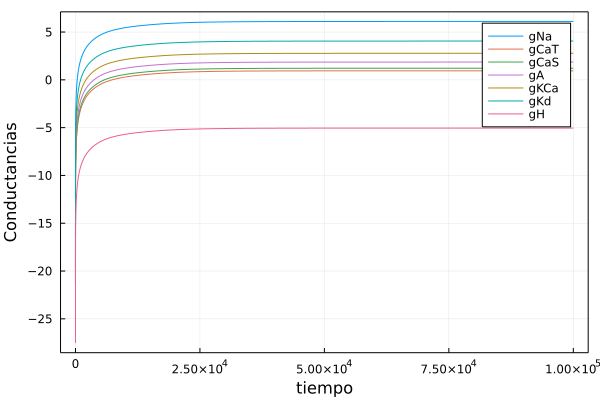

In [28]:
# De nuevo ploteamos las conductancias con otro rango de valores 
plot(t[1:100:1000000],log.(gna[1:100:1000000]),label="gNa",xlabel="tiempo",ylabel="Conductancias")
plot!(t[1:100:1000000],log.(gcat[1:100:1000000]),label="gCaT")
plot!(t[1:100:1000000],log.(gcas[1:100:1000000]),label="gCaS")
plot!(t[1:100:1000000],log.(ga[1:100:1000000]),label="gA")
plot!(t[1:100:1000000],log.(gkca[1:100:1000000]),label="gKCa")
plot!(t[1:100:1000000],log.(gkd[1:100:1000000]),label="gKd")
plot!(t[1:100:1000000],log.(gh[1:100:1000000]),label="gH")
#savefig("ConductanciasPrueba")

## Como parte de las diferentes pruebas para el modelo procederemos a testear el modelo con diferentes condiciones en las cuales se quitaran conductancias para ver su desarrollo del modelo.
### Quitando gCaT
ahora quitamos una conductancia importante para ver como evoluciona el modelo.

In [29]:
function stgjafet_CaT_out(h,t,p,r)
   
    #########################
    tiempo=1:t
    tiempo2=length(tiempo)/100
    #########################
    Vpoints=zeros(convert(Int64,tiempo2))
    Ca2points=zeros(convert(Int64,tiempo2))
    gNapoints=zeros(convert(Int64,tiempo2))
    gCaTpoints=zeros(convert(Int64,tiempo2))
    gCaSpoints=zeros(convert(Int64,tiempo2))
    gApoints=zeros(convert(Int64,tiempo2))
    gKCapoints=zeros(convert(Int64,tiempo2))
    gKdpoints=zeros(convert(Int64,tiempo2))
    gHpoints=zeros(convert(Int64,tiempo2))
    ###########################
    # p[]
    I=p[1]
    taugg=p[2]
    taumm=p[3]
    gtgtNa=p[4]
    gtgtCaT=p[5]
    gtgtCaS=p[6]
    gtgtA=p[7]
    gtgtKCa=p[8]
    gtgtKd=p[9]
    gtgtH=p[10]
    catgt=p[11]
    gL=p[12]
    ##########################
    #(V,Ca,m1,m2,m3,m4,m5,m6,m7,h1,h2,h3,h4,g1,g2,g3,g4,g5,g6,g7,mg1,mg2,mg3,mg4,mg5,mg6,mg7)
    #condiciones iniciales
    #r[]
    Vpoints[1]=V=r[1]
    Ca2points[1]=Ca2=r[2]
    mNa=minf1(V)
    mCaT=minf2(V)
    mCaS=minf3(V)
    mA=minf4(V)
    mKCa=minf5(V,Ca2)
    mKd=minf6(V)
    mH=minf7(V)
    hNa=hinf1(V)
    hCaT=hinf2(V)
    hCaS=hinf3(V)
    hA=hinf4(V)
    gNapoints[1]=gNa=r[3]
    gCaTpoints[1]=gCaT=r[4]
    gCaSpoints[1]=gCaS=r[5]
    gApoints[1]=gA=r[6]
    gKCapoints[1]=gKCa=r[7]
    gKdpoints[1]=gKd=r[8]
    gHpoints[1]=gH=r[9]
    mgNa=gNa
    mgCaT=gCaT
    mgCaS=gCaS
    mgA=gA
    mgKCa=gKCa
    mgKd=gKd
    mgH=gH
    ##########################
    for i=2:length(tiempo)
        if i>=90000000
            V += h* 1/C * ( I -(gNa*mNa^3*hNa*(V-ENa)+0*gCaT*mCaT^3*hCaT*(V-ECa)+gCaS*mCaS^3*hCaS*(V-ECa)
                +gA*mA^3*hA*(V-EK)+gKCa*mKCa^4*(V-EK)+gKd*mKd^4*(V-EK)+gH*mH*(V-EH)+gL*(V-EL)))
        
            Ca2 += h*(-0.94*(0*gCaT*mCaT^3*hCaT*(V-ECa)+gCaS*mCaS^3*hCaS*(V-ECa))-Ca2+0.05)
        
            mNa+= h/taum1(V)*(minf1(V)-mNa)
            mCaT+= h/taum2(V)*(minf2(V)-mCaT)
            mCaS+= h/taum3(V)*(minf3(V)-mCaS)
            mA+= h/taum4(V)*(minf4(V)-mA)
            mKCa+= h/taum5(V)*(minf5(V,Ca2)-mKCa)
            mKd+= h/taum6(V)*(minf6(V)-mKd)
            mH+= h/taum7(V)*(minf7(V)-mH)
            
            hNa += h/tauh1(V)*(hinf1(V)-hNa)
            hCaT += h/tauh2(V)*(hinf2(V)-hCaT)
            hCaS += h/tauh3(V)*(hinf3(V)-hCaS)
            hA += h/tauh4(V)*(hinf4(V)-hA)
            
            gNa += h/taugg*(mgNa-gNa)
            gCaT += h/taugg*(mgCaT-gCaT)*0
            gCaS += h/taugg*(mgCaS-gCaS)
            gA += h/taugg*(mgA-gA)
            gKCa += h/taugg*(mgKCa-gKCa)
            gKd += h/taugg*(mgKd-gKd)
            gH += h/taugg*(mgH-gH)
            
            mgNa += h/taumm*gtgtNa*(catgt-Ca2)
            mgCaT += h/taumm*gtgtCaT*(catgt-Ca2)
            mgCaS += h/taumm*gtgtCaS*(catgt-Ca2)
            mgA += h/taumm*gtgtA*(catgt-Ca2)
            mgKCa += h/taumm*gtgtKCa*(catgt-Ca2)
            mgKd += h/taumm*gtgtKd*(catgt-Ca2)
            mgH += h/taumm*gtgtH*(catgt-Ca2)
        
        else
            V += h* 1/C * ( I -(gNa*mNa^3*hNa*(V-ENa)+gCaT*mCaT^3*hCaT*(V-ECa)+gCaS*mCaS^3*hCaS*(V-ECa)
                +gA*mA^3*hA*(V-EK)+gKCa*mKCa^4*(V-EK)+gKd*mKd^4*(V-EK)+gH*mH*(V-EH)+gL*(V-EL)))
        
            Ca2 += h*(-0.94*(gCaT*mCaT^3*hCaT*(V-ECa)+gCaS*mCaS^3*hCaS*(V-ECa))-Ca2+0.05)
            
            mNa+= h/taum1(V)*(minf1(V)-mNa)
            mCaT+= h/taum2(V)*(minf2(V)-mCaT)
            mCaS+= h/taum3(V)*(minf3(V)-mCaS)
            mA+= h/taum4(V)*(minf4(V)-mA)
            mKCa+= h/taum5(V)*(minf5(V,Ca2)-mKCa)
            mKd+= h/taum6(V)*(minf6(V)-mKd)
            mH+= h/taum7(V)*(minf7(V)-mH)
            
            hNa += h/tauh1(V)*(hinf1(V)-hNa)
            hCaT += h/tauh2(V)*(hinf2(V)-hCaT)
            hCaS += h/tauh3(V)*(hinf3(V)-hCaS)
            hA += h/tauh4(V)*(hinf4(V)-hA)
            
            gNa += h/taugg*(mgNa-gNa)
            gCaT += h/taugg*(mgCaT-gCaT)
            gCaS += h/taugg*(mgCaS-gCaS)
            gA += h/taugg*(mgA-gA)
            gKCa += h/taugg*(mgKCa-gKCa)
            gKd += h/taugg*(mgKd-gKd)
            gH += h/taugg*(mgH-gH)
            
            mgNa += h/taumm*gtgtNa*(catgt-Ca2)
            mgCaT += h/taumm*gtgtCaT*(catgt-Ca2)
            mgCaS += h/taumm*gtgtCaS*(catgt-Ca2)
            mgA += h/taumm*gtgtA*(catgt-Ca2)
            mgKCa += h/taumm*gtgtKCa*(catgt-Ca2)
            mgKd += h/taumm*gtgtKd*(catgt-Ca2)
            mgH += h/taumm*gtgtH*(catgt-Ca2)
        end
            
            
            
            
        istep= convert(Int64,ceil(i/100))
        
        Vpoints[istep]=V
        Ca2points[istep]=Ca2
        gNapoints[istep]=gNa
        gCaTpoints[istep]=gCaT
        gCaSpoints[istep]=gCaS
        gApoints[istep]=gA
        gKCapoints[istep]=gKCa
        gKdpoints[istep]=gKd
        gHpoints[istep]=gH
        
    end
    return Vpoints,Ca2points,gNapoints,gCaTpoints,gCaSpoints,gApoints,gKCapoints,gKdpoints,gHpoints
end

stgjafet_CaT_out (generic function with 1 method)

In [30]:
### tienes que crear p y r para crear parametros iniciales donde
## p =(I,taugg,taumm,gtgtNa,gtgtCaT,gtgtCaS,gtgtA,gtgtKCa,gtgtKd,gtgtH,catgt,gL)
## r =(V,Ca,gNa,gCaT,gCaS,gA,gKCa,gKd,gH)

p=Array{Float64}([0.0,2*10e2,10e5,700.,4.,5.25,10.,25.,90.,0.01,50.,0.01])
r=Array{Float64}([-20.,5.,0.,0.,0.,0.,0.,0.,0.])

@time v_1,Ca2_1,gna_1,gcat_1,gcas_1,ga_1,gkca_1,gkd_1,gh_1=stgjafet_CaT_out(0.001,150000000,p,r);

 48.956170 seconds (203.52 k allocations: 113.572 MiB, 0.06% gc time, 0.38% compilation time)


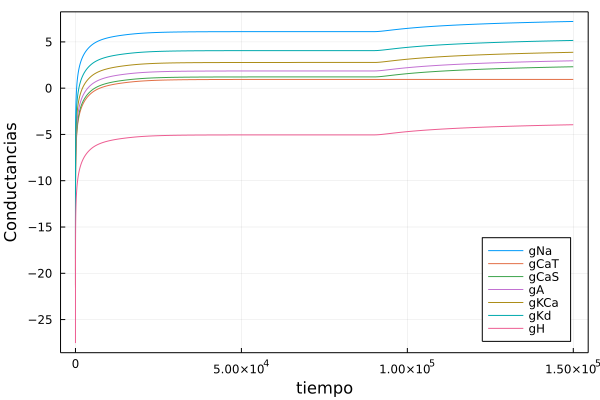

In [32]:
plot(t[1:100:1500000],log.(gna_1[1:100:1500000]),label="gNa",xlabel="tiempo",ylabel="Conductancias",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcat_1[1:100:1500000]),label="gCaT",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcas_1[1:100:1500000]),label="gCaS",legend=:bottomright)
plot!(t[1:100:1500000],log.(ga_1[1:100:1500000]),label="gA",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkca_1[1:100:1500000]),label="gKCa",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkd_1[1:100:1500000]),label="gKd",legend=:bottomright)
plot!(t[1:100:1500000],log.(gh_1[1:100:1500000]),label="gH",legend=:bottomright)
#savefig("Conductancias_bursting_gcat")

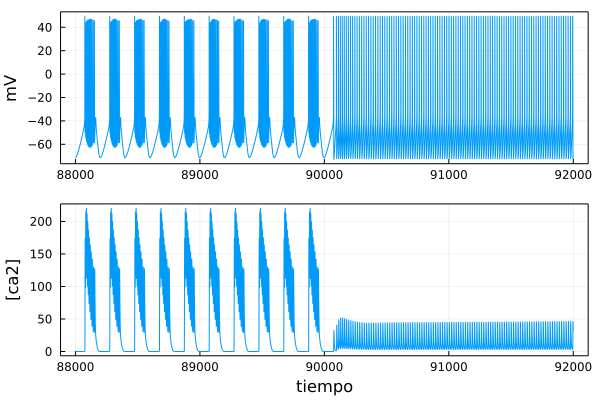

In [38]:
#Cambio rempentino de frecuencia de las espigas debido a la compensación de la conductancia
p_prueba=plot(t[880000:920000],v_1[880000:920000],legend=false,ylabel="mV")
p_prueba2=plot(t[880000:920000],Ca2_1[880000:920000],legend=false,xlabel="tiempo",ylabel="[ca2]")
plot(p_prueba,p_prueba2,layout=(2,1))
#savefig("gcat_doble")

# Quitando gH
Otra prueba quitando otra conductancia.

In [45]:

function stgjafet_H_out(h,t,p,r)
   
    #########################
    tiempo=1:t
    tiempo2=length(tiempo)/100
    #########################
    Vpoints=zeros(convert(Int64,tiempo2))
    Ca2points=zeros(convert(Int64,tiempo2))
    gNapoints=zeros(convert(Int64,tiempo2))
    gCaTpoints=zeros(convert(Int64,tiempo2))
    gCaSpoints=zeros(convert(Int64,tiempo2))
    gApoints=zeros(convert(Int64,tiempo2))
    gKCapoints=zeros(convert(Int64,tiempo2))
    gKdpoints=zeros(convert(Int64,tiempo2))
    gHpoints=zeros(convert(Int64,tiempo2))
    ###########################
    # p[]
    I=p[1]
    taugg=p[2]
    taumm=p[3]
    gtgtNa=p[4]
    gtgtCaT=p[5]
    gtgtCaS=p[6]
    gtgtA=p[7]
    gtgtKCa=p[8]
    gtgtKd=p[9]
    gtgtH=p[10]
    catgt=p[11]
    gL=p[12]
    ##########################
    #(V,Ca,m1,m2,m3,m4,m5,m6,m7,h1,h2,h3,h4,g1,g2,g3,g4,g5,g6,g7,mg1,mg2,mg3,mg4,mg5,mg6,mg7)
    #condiciones iniciales
    #r[]
    Vpoints[1]=V=r[1]
    Ca2points[1]=Ca2=r[2]
    mNa=minf1(V)
    mCaT=minf2(V)
    mCaS=minf3(V)
    mA=minf4(V)
    mKCa=minf5(V,Ca2)
    mKd=minf6(V)
    mH=minf7(V)
    hNa=hinf1(V)
    hCaT=hinf2(V)
    hCaS=hinf3(V)
    hA=hinf4(V)
    gNapoints[1]=gNa=r[3]
    gCaTpoints[1]=gCaT=r[4]
    gCaSpoints[1]=gCaS=r[5]
    gApoints[1]=gA=r[6]
    gKCapoints[1]=gKCa=r[7]
    gKdpoints[1]=gKd=r[8]
    gHpoints[1]=gH=r[9]
    mgNa=gNa
    mgCaT=gCaT
    mgCaS=gCaS
    mgA=gA
    mgKCa=gKCa
    mgKd=gKd
    mgH=gH
    ##########################
    for i=2:length(tiempo)
        if i>=90000000
            V += h* 1/C * ( I -(gNa*mNa^3*hNa*(V-ENa)+gCaT*mCaT^3*hCaT*(V-ECa)+gCaS*mCaS^3*hCaS*(V-ECa)
                +gA*mA^3*hA*(V-EK)+gKCa*mKCa^4*(V-EK)+gKd*mKd^4*(V-EK)+0*gH*mH*(V-EH)+gL*(V-EL)))
        
            Ca2 += h*(-0.94*(gCaT*mCaT^3*hCaT*(V-ECa)+gCaS*mCaS^3*hCaS*(V-ECa))-Ca2+0.05)
        
            mNa+= h/taum1(V)*(minf1(V)-mNa)
            mCaT+= h/taum2(V)*(minf2(V)-mCaT)
            mCaS+= h/taum3(V)*(minf3(V)-mCaS)
            mA+= h/taum4(V)*(minf4(V)-mA)
            mKCa+= h/taum5(V)*(minf5(V,Ca2)-mKCa)
            mKd+= h/taum6(V)*(minf6(V)-mKd)
            mH+= h/taum7(V)*(minf7(V)-mH)
            
            hNa += h/tauh1(V)*(hinf1(V)-hNa)
            hCaT += h/tauh2(V)*(hinf2(V)-hCaT)
            hCaS += h/tauh3(V)*(hinf3(V)-hCaS)
            hA += h/tauh4(V)*(hinf4(V)-hA)
            
            gNa += h/taugg*(mgNa-gNa)
            gCaT += h/taugg*(mgCaT-gCaT)
            gCaS += h/taugg*(mgCaS-gCaS)
            gA += h/taugg*(mgA-gA)
            gKCa += h/taugg*(mgKCa-gKCa)
            gKd += h/taugg*(mgKd-gKd)
            gH += h/taugg*(mgH-gH)*0
            
            mgNa += h/taumm*gtgtNa*(catgt-Ca2)
            mgCaT += h/taumm*gtgtCaT*(catgt-Ca2)
            mgCaS += h/taumm*gtgtCaS*(catgt-Ca2)
            mgA += h/taumm*gtgtA*(catgt-Ca2)
            mgKCa += h/taumm*gtgtKCa*(catgt-Ca2)
            mgKd += h/taumm*gtgtKd*(catgt-Ca2)
            mgH += h/taumm*gtgtH*(catgt-Ca2)
        
        else
            V += h* 1/C * ( I -(gNa*mNa^3*hNa*(V-ENa)+gCaT*mCaT^3*hCaT*(V-ECa)+gCaS*mCaS^3*hCaS*(V-ECa)
                +gA*mA^3*hA*(V-EK)+gKCa*mKCa^4*(V-EK)+gKd*mKd^4*(V-EK)+gH*mH*(V-EH)+gL*(V-EL)))
        
            Ca2 += h*(-0.94*(gCaT*mCaT^3*hCaT*(V-ECa)+gCaS*mCaS^3*hCaS*(V-ECa))-Ca2+0.05)
            
            mNa+= h/taum1(V)*(minf1(V)-mNa)
            mCaT+= h/taum2(V)*(minf2(V)-mCaT)
            mCaS+= h/taum3(V)*(minf3(V)-mCaS)
            mA+= h/taum4(V)*(minf4(V)-mA)
            mKCa+= h/taum5(V)*(minf5(V,Ca2)-mKCa)
            mKd+= h/taum6(V)*(minf6(V)-mKd)
            mH+= h/taum7(V)*(minf7(V)-mH)
            
            hNa += h/tauh1(V)*(hinf1(V)-hNa)
            hCaT += h/tauh2(V)*(hinf2(V)-hCaT)
            hCaS += h/tauh3(V)*(hinf3(V)-hCaS)
            hA += h/tauh4(V)*(hinf4(V)-hA)
            
            gNa += h/taugg*(mgNa-gNa)
            gCaT += h/taugg*(mgCaT-gCaT)
            gCaS += h/taugg*(mgCaS-gCaS)
            gA += h/taugg*(mgA-gA)
            gKCa += h/taugg*(mgKCa-gKCa)
            gKd += h/taugg*(mgKd-gKd)
            gH += h/taugg*(mgH-gH)
            
            mgNa += h/taumm*gtgtNa*(catgt-Ca2)
            mgCaT += h/taumm*gtgtCaT*(catgt-Ca2)
            mgCaS += h/taumm*gtgtCaS*(catgt-Ca2)
            mgA += h/taumm*gtgtA*(catgt-Ca2)
            mgKCa += h/taumm*gtgtKCa*(catgt-Ca2)
            mgKd += h/taumm*gtgtKd*(catgt-Ca2)
            mgH += h/taumm*gtgtH*(catgt-Ca2)
        end
            
            
            
            
        istep= convert(Int64,ceil(i/100))
        
        Vpoints[istep]=V
        Ca2points[istep]=Ca2
        gNapoints[istep]=gNa
        gCaTpoints[istep]=gCaT
        gCaSpoints[istep]=gCaS
        gApoints[istep]=gA
        gKCapoints[istep]=gKCa
        gKdpoints[istep]=gKd
        gHpoints[istep]=gH
        
    end
    return Vpoints,Ca2points,gNapoints,gCaTpoints,gCaSpoints,gApoints,gKCapoints,gKdpoints,gHpoints
end

stgjafet_H_out (generic function with 1 method)

In [40]:
###Mismo tratamiento 
## p =(I,taugg,taumm,gtgtNa,gtgtCaT,gtgtCaS,gtgtA,gtgtKCa,gtgtKd,gtgtH,catgt,gL)
## r =(V,Ca,gNa,gCaT,gCaS,gA,gKCa,gKd,gH)

p=Array{Float64}([0.0,2*10e2,10e5,700.,4.,5.25,10.,25.,90.,0.01,50.,0.01])
r=Array{Float64}([-20.,5.,0.,0.,0.,0.,0.,0.,0.])

@time v_2,Ca2_2,gna_2,gcat_2,gcas_2,ga_2,gkca_2,gkd_2,gh_2=stgjafet_H_out(0.001,150000000,p,r);

 47.325630 seconds (196.31 k allocations: 113.107 MiB, 0.33% compilation time)


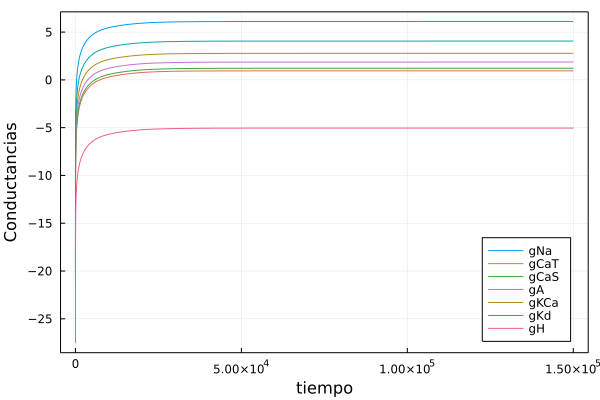

In [43]:
plot(t[1:100:1500000],log.(gna_2[1:100:1500000]),label="gNa",xlabel="tiempo",ylabel="Conductancias",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcat_2[1:100:1500000]),label="gCaT",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcas_2[1:100:1500000]),label="gCaS",legend=:bottomright)
plot!(t[1:100:1500000],log.(ga_2[1:100:1500000]),label="gA",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkca_2[1:100:1500000]),label="gKCa",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkd_2[1:100:1500000]),label="gKd",legend=:bottomright)
plot!(t[1:100:1500000],log.(gh_2[1:100:1500000]),label="gH",legend=:bottomright)
#savefig("Conductancias_bursting_gh")

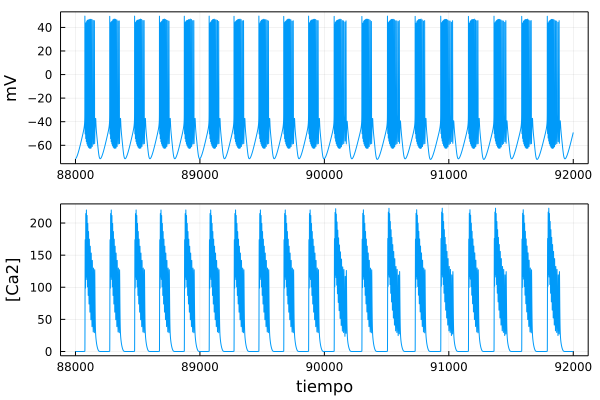

In [44]:
pl1=plot(t[880000:920000],v_2[880000:920000],ylabel="mV",legend=false)
pl2=plot(t[880000:920000],Ca2_2[880000:920000],xlabel="tiempo",ylabel="[Ca2]",legend=false)
plot(pl1,pl2,layout=(2,1))
#savefig("gh_doble")

# Quitando gCaS

In [46]:

function stgjafet_CaS_out(h,t,p,r)
   
    #########################
    tiempo=1:t
    tiempo2=length(tiempo)/100
    #########################
    Vpoints=zeros(convert(Int64,tiempo2))
    Ca2points=zeros(convert(Int64,tiempo2))
    gNapoints=zeros(convert(Int64,tiempo2))
    gCaTpoints=zeros(convert(Int64,tiempo2))
    gCaSpoints=zeros(convert(Int64,tiempo2))
    gApoints=zeros(convert(Int64,tiempo2))
    gKCapoints=zeros(convert(Int64,tiempo2))
    gKdpoints=zeros(convert(Int64,tiempo2))
    gHpoints=zeros(convert(Int64,tiempo2))
    ###########################
    # p[]
    I=p[1]
    taugg=p[2]
    taumm=p[3]
    gtgtNa=p[4]
    gtgtCaT=p[5]
    gtgtCaS=p[6]
    gtgtA=p[7]
    gtgtKCa=p[8]
    gtgtKd=p[9]
    gtgtH=p[10]
    catgt=p[11]
    gL=p[12]
    ##########################
    #(V,Ca,m1,m2,m3,m4,m5,m6,m7,h1,h2,h3,h4,g1,g2,g3,g4,g5,g6,g7,mg1,mg2,mg3,mg4,mg5,mg6,mg7)
    #condiciones iniciales
    #r[]
    Vpoints[1]=V=r[1]
    Ca2points[1]=Ca2=r[2]
    mNa=minf1(V)
    mCaT=minf2(V)
    mCaS=minf3(V)
    mA=minf4(V)
    mKCa=minf5(V,Ca2)
    mKd=minf6(V)
    mH=minf7(V)
    hNa=hinf1(V)
    hCaT=hinf2(V)
    hCaS=hinf3(V)
    hA=hinf4(V)
    gNapoints[1]=gNa=r[3]
    gCaTpoints[1]=gCaT=r[4]
    gCaSpoints[1]=gCaS=r[5]
    gApoints[1]=gA=r[6]
    gKCapoints[1]=gKCa=r[7]
    gKdpoints[1]=gKd=r[8]
    gHpoints[1]=gH=r[9]
    mgNa=gNa
    mgCaT=gCaT
    mgCaS=gCaS
    mgA=gA
    mgKCa=gKCa
    mgKd=gKd
    mgH=gH
    ##########################
    for i=2:length(tiempo)
        if i>=90000000
            V += h* 1/C * ( I -(gNa*mNa^3*hNa*(V-ENa)+gCaT*mCaT^3*hCaT*(V-ECa)+0*gCaS*mCaS^3*hCaS*(V-ECa)
                +gA*mA^3*hA*(V-EK)+gKCa*mKCa^4*(V-EK)+gKd*mKd^4*(V-EK)+gH*mH*(V-EH)+gL*(V-EL)))
        
            Ca2 += h*(-0.94*(gCaT*mCaT^3*hCaT*(V-ECa)+0*gCaS*mCaS^3*hCaS*(V-ECa))-Ca2+0.05)
        
            mNa+= h/taum1(V)*(minf1(V)-mNa)
            mCaT+= h/taum2(V)*(minf2(V)-mCaT)
            mCaS+= h/taum3(V)*(minf3(V)-mCaS)
            mA+= h/taum4(V)*(minf4(V)-mA)
            mKCa+= h/taum5(V)*(minf5(V,Ca2)-mKCa)
            mKd+= h/taum6(V)*(minf6(V)-mKd)
            mH+= h/taum7(V)*(minf7(V)-mH)
            
            hNa += h/tauh1(V)*(hinf1(V)-hNa)
            hCaT += h/tauh2(V)*(hinf2(V)-hCaT)
            hCaS += h/tauh3(V)*(hinf3(V)-hCaS)
            hA += h/tauh4(V)*(hinf4(V)-hA)
            
            gNa += h/taugg*(mgNa-gNa)
            gCaT += h/taugg*(mgCaT-gCaT)
            gCaS += h/taugg*(mgCaS-gCaS)*0
            gA += h/taugg*(mgA-gA)
            gKCa += h/taugg*(mgKCa-gKCa)
            gKd += h/taugg*(mgKd-gKd)
            gH += h/taugg*(mgH-gH)
            
            mgNa += h/taumm*gtgtNa*(catgt-Ca2)
            mgCaT += h/taumm*gtgtCaT*(catgt-Ca2)
            mgCaS += h/taumm*gtgtCaS*(catgt-Ca2)
            mgA += h/taumm*gtgtA*(catgt-Ca2)
            mgKCa += h/taumm*gtgtKCa*(catgt-Ca2)
            mgKd += h/taumm*gtgtKd*(catgt-Ca2)
            mgH += h/taumm*gtgtH*(catgt-Ca2)
        
        else
            V += h* 1/C * ( I -(gNa*mNa^3*hNa*(V-ENa)+gCaT*mCaT^3*hCaT*(V-ECa)+gCaS*mCaS^3*hCaS*(V-ECa)
                +gA*mA^3*hA*(V-EK)+gKCa*mKCa^4*(V-EK)+gKd*mKd^4*(V-EK)+gH*mH*(V-EH)+gL*(V-EL)))
        
            Ca2 += h*(-0.94*(gCaT*mCaT^3*hCaT*(V-ECa)+gCaS*mCaS^3*hCaS*(V-ECa))-Ca2+0.05)
            
            mNa+= h/taum1(V)*(minf1(V)-mNa)
            mCaT+= h/taum2(V)*(minf2(V)-mCaT)
            mCaS+= h/taum3(V)*(minf3(V)-mCaS)
            mA+= h/taum4(V)*(minf4(V)-mA)
            mKCa+= h/taum5(V)*(minf5(V,Ca2)-mKCa)
            mKd+= h/taum6(V)*(minf6(V)-mKd)
            mH+= h/taum7(V)*(minf7(V)-mH)
            
            hNa += h/tauh1(V)*(hinf1(V)-hNa)
            hCaT += h/tauh2(V)*(hinf2(V)-hCaT)
            hCaS += h/tauh3(V)*(hinf3(V)-hCaS)
            hA += h/tauh4(V)*(hinf4(V)-hA)
            
            gNa += h/taugg*(mgNa-gNa)
            gCaT += h/taugg*(mgCaT-gCaT)
            gCaS += h/taugg*(mgCaS-gCaS)
            gA += h/taugg*(mgA-gA)
            gKCa += h/taugg*(mgKCa-gKCa)
            gKd += h/taugg*(mgKd-gKd)
            gH += h/taugg*(mgH-gH)
            
            mgNa += h/taumm*gtgtNa*(catgt-Ca2)
            mgCaT += h/taumm*gtgtCaT*(catgt-Ca2)
            mgCaS += h/taumm*gtgtCaS*(catgt-Ca2)
            mgA += h/taumm*gtgtA*(catgt-Ca2)
            mgKCa += h/taumm*gtgtKCa*(catgt-Ca2)
            mgKd += h/taumm*gtgtKd*(catgt-Ca2)
            mgH += h/taumm*gtgtH*(catgt-Ca2)
        end
            
            
            
            
        istep= convert(Int64,ceil(i/100))
        
        Vpoints[istep]=V
        Ca2points[istep]=Ca2
        gNapoints[istep]=gNa
        gCaTpoints[istep]=gCaT
        gCaSpoints[istep]=gCaS
        gApoints[istep]=gA
        gKCapoints[istep]=gKCa
        gKdpoints[istep]=gKd
        gHpoints[istep]=gH
        
    end
    return Vpoints,Ca2points,gNapoints,gCaTpoints,gCaSpoints,gApoints,gKCapoints,gKdpoints,gHpoints
end

stgjafet_CaS_out (generic function with 1 method)

In [47]:
## p =(I,taugg,taumm,gtgtNa,gtgtCaT,gtgtCaS,gtgtA,gtgtKCa,gtgtKd,gtgtH,catgt,gL)
## r =(V,Ca,gNa,gCaT,gCaS,gA,gKCa,gKd,gH)

p=Array{Float64}([0.0,2*10e2,10e5,700.,4.,5.25,10.,25.,90.,0.01,50.,0.01])
r=Array{Float64}([-20.,5.,0.,0.,0.,0.,0.,0.,0.])

@time v_3,Ca2_3,gna_3,gcat_3,gcas_3,ga_3,gkca_3,gkd_3,gh_3=stgjafet_CaS_out(0.001,150000000,p,r);

 48.676023 seconds (194.37 k allocations: 113.001 MiB, 0.04% gc time, 0.31% compilation time)


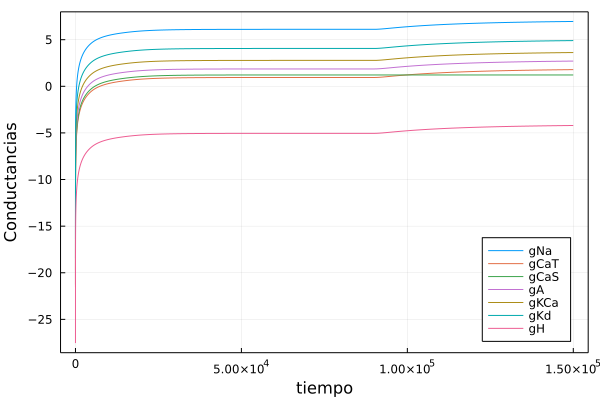

In [50]:
plot(t[1:100:1500000],log.(gna_3[1:100:1500000]),label="gNa",xlabel="tiempo",ylabel="Conductancias",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcat_3[1:100:1500000]),label="gCaT",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcas_3[1:100:1500000]),label="gCaS",legend=:bottomright)
plot!(t[1:100:1500000],log.(ga_3[1:100:1500000]),label="gA",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkca_3[1:100:1500000]),label="gKCa",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkd_3[1:100:1500000]),label="gKd",legend=:bottomright)
plot!(t[1:100:1500000],log.(gh_3[1:100:1500000]),label="gH",legend=:bottomright)
#savefig("Conductancias_bursting_gcas")

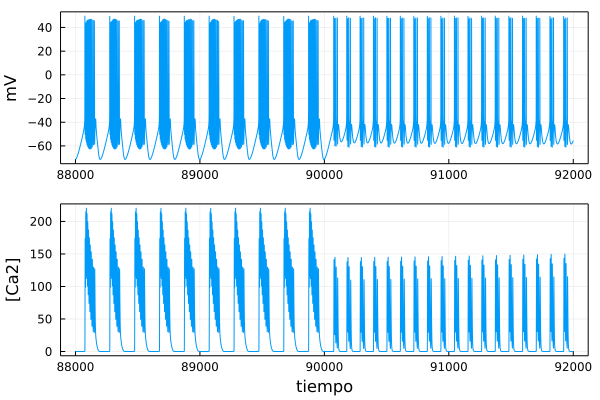

In [51]:
p1_11=plot(t[880000:920000],v_3[880000:920000],legend=false,ylabel="mV")
p2_11=plot(t[880000:920000],Ca2_3[880000:920000],legend=false,ylabel="[Ca2]",xlabel="tiempo")
plot(p1_11,p2_11,layout=(2,1))
#savefig("gcas_doble")

# TonicSpiking

### Ahora veremos otro tipo de spikes , y lo probaremos con diferentes modelos, esto lo logramos modificando los parametros iniciales "r"

In [52]:
## p =(I,taugg,taumm,gtgtNa,gtgtCaT,gtgtCaS,gtgtA,gtgtKCa,gtgtKd,gtgtH,catgt,gL)
## r =(V,Ca,gNa,gCaT,gCaS,gA,gKCa,gKd,gH)

p=Array{Float64}([0.0,2*10e2,10e5,700.,4.,5.25,130.,25.,90.,0.01,50.,0.01])
r=Array{Float64}([-20.,5.,0.,0.,0.,0.,0.,0.,0.])

@time v,Ca2,gna,gcat,gcas,ga,gkca,gkd,gh=stgjafet(0.001,150000000,p,r);

 45.317161 seconds (28 allocations: 102.998 MiB)


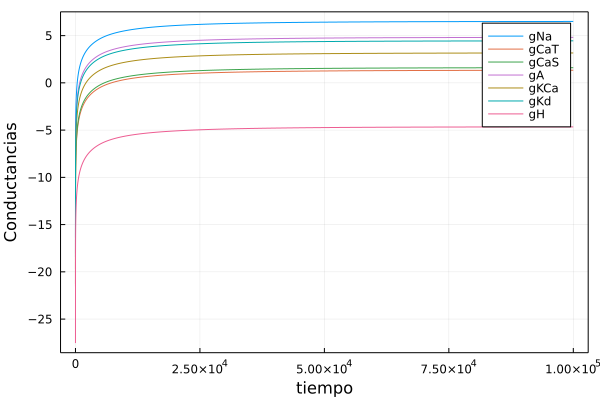

In [54]:
plot(t[1:100:1000000],log.(gna[1:100:1000000]),label="gNa",xlabel="tiempo",ylabel="Conductancias")
plot!(t[1:100:1000000],log.(gcat[1:100:1000000]),label="gCaT")
plot!(t[1:100:1000000],log.(gcas[1:100:1000000]),label="gCaS")
plot!(t[1:100:1000000],log.(ga[1:100:1000000]),label="gA")
plot!(t[1:100:1000000],log.(gkca[1:100:1000000]),label="gKCa")
plot!(t[1:100:1000000],log.(gkd[1:100:1000000]),label="gKd")
plot!(t[1:100:1000000],log.(gh[1:100:1000000]),label="gH")
#savefig("Conductancias_tonic")

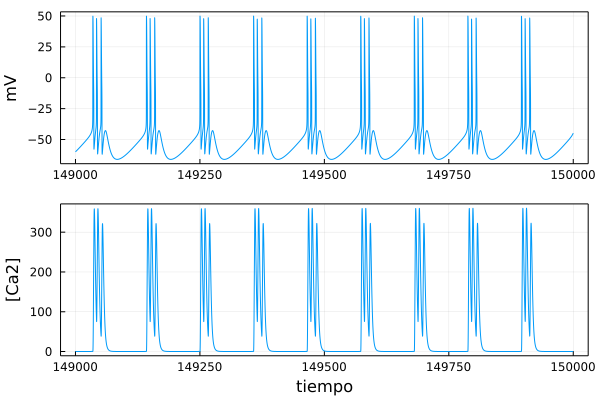

In [56]:
default(framestyle= :box)
plot(p1,p2,layout=(2,1))
#savefig("tonic_1")

# quit caT

In [57]:

## p =(I,taugg,taumm,gtgtNa,gtgtCaT,gtgtCaS,gtgtA,gtgtKCa,gtgtKd,gtgtH,catgt,gL)
## r =(V,Ca,gNa,gCaT,gCaS,gA,gKCa,gKd,gH)

p=Array{Float64}([0.0,2*10e2,10e5,700.,4.,5.25,130.,25.,90.,0.01,50.,0.01])
r=Array{Float64}([-20.,5.,0.,0.,0.,0.,0.,0.,0.])

@time v_1_2,Ca2_1_2,gna_1_2,gcat_1_2,gcas_1_2,ga_1_2,gkca_1_2,gkd_1_2,gh_1_2=stgjafet_CaT_out(0.001,150000000,p,r);

 49.083816 seconds (28 allocations: 102.998 MiB)


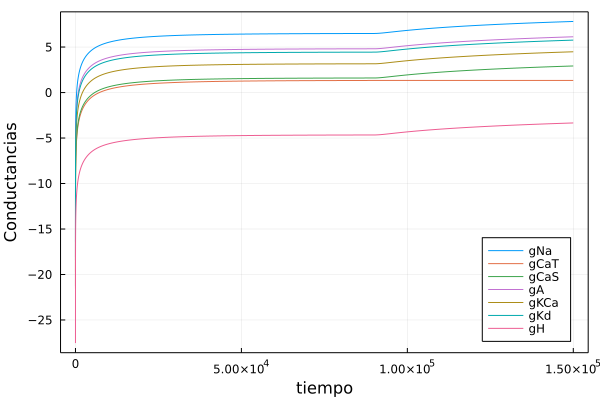

In [59]:
plot(t[1:100:1500000],log.(gna_1_2[1:100:1500000]),label="gNa",xlabel="tiempo",ylabel="Conductancias",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcat_1_2[1:100:1500000]),label="gCaT",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcas_1_2[1:100:1500000]),label="gCaS",legend=:bottomright)
plot!(t[1:100:1500000],log.(ga_1_2[1:100:1500000]),label="gA",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkca_1_2[1:100:1500000]),label="gKCa",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkd_1_2[1:100:1500000]),label="gKd",legend=:bottomright)
plot!(t[1:100:1500000],log.(gh_1_2[1:100:1500000]),label="gH",legend=:bottomright)
#savefig("Conductancias_tonic_gcat")

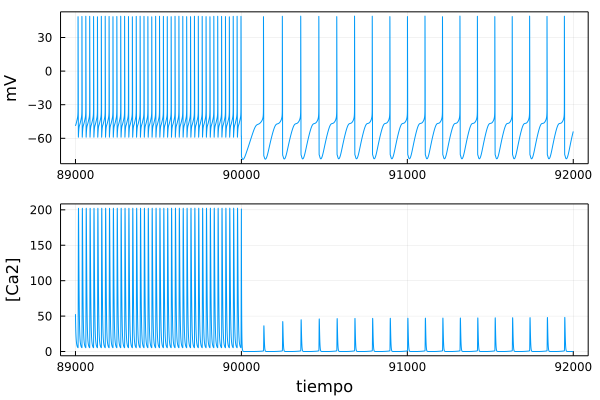

In [60]:
p_1=plot(t[890000:920000],v_1_2[890000:920000],legend=false,ylabel="mV")
p_2=plot(t[890000:920000],Ca2_1_2[890000:920000],legend=false,ylabel="[Ca2]",xlabel="tiempo")
plot(p_1,p_2,layout=(2,1))
#savefig("tonicgcat_doble")

### Quitamos $g_{H}$

In [61]:
###tienes que crear p y r donde
## p =(I,taugg,taumm,gtgtNa,gtgtCaT,gtgtCaS,gtgtA,gtgtKCa,gtgtKd,gtgtH,catgt,gL)
## r =(V,Ca,gNa,gCaT,gCaS,gA,gKCa,gKd,gH)

p=Array{Float64}([0.0,2*10e2,10e5,700.,4.,5.25,130.,25.,90.,0.01,50.,0.01])
r=Array{Float64}([-20.,5.,0.,0.,0.,0.,0.,0.,0.])

@time v_2,Ca2_2,gna_2,gcat_2,gcas_2,ga_2,gkca_2,gkd_2,gh_2=stgjafet_H_out(0.001,150000000,p,r);

 49.881350 seconds (194.49 k allocations: 113.003 MiB, 0.32% compilation time)


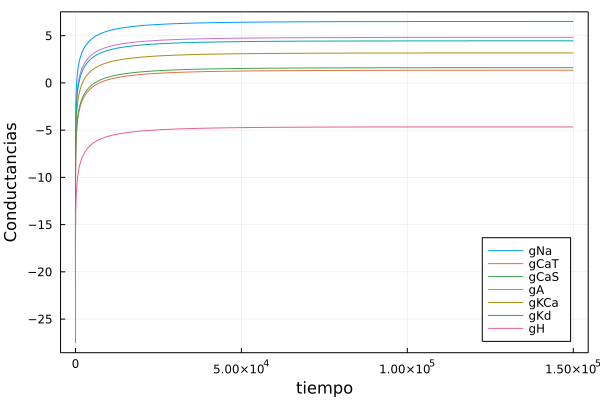

In [63]:
plot(t[1:100:1500000],log.(gna_2[1:100:1500000]),label="gNa",xlabel="tiempo",ylabel="Conductancias",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcat_2[1:100:1500000]),label="gCaT",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcas_2[1:100:1500000]),label="gCaS",legend=:bottomright)
plot!(t[1:100:1500000],log.(ga_2[1:100:1500000]),label="gA",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkca_2[1:100:1500000]),label="gKCa",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkd_2[1:100:1500000]),label="gKd",legend=:bottomright)
plot!(t[1:100:1500000],log.(gh_2[1:100:1500000]),label="gH",legend=:bottomright)
#savefig("Conductancias_tonic_gh")

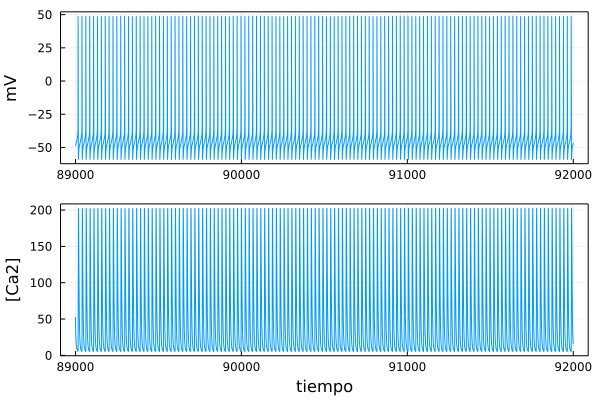

In [64]:
plott_1h=plot(t[890000:920000],v_2[890000:920000],legend=false,ylabel="mV")
plott_2h=plot(t[890000:920000],Ca2_2[890000:920000],legend=false,ylabel="[Ca2]",xlabel="tiempo")
plot(plott_1h,plott_2h,layout=(2,1))
#savefig("tonicgh_doble")

In [68]:
###tienes que crear p y r donde
## p =(I,taugg,taumm,gtgtNa,gtgtCaT,gtgtCaS,gtgtA,gtgtKCa,gtgtKd,gtgtH,catgt,gL)
## r =(V,Ca,gNa,gCaT,gCaS,gA,gKCa,gKd,gH)

p=Array{Float64}([0.0,2*10e2,10e5,700.,4.,5.25,130.,25.,90.,0.01,50.,0.01])
r=Array{Float64}([-20.,5.,0.,0.,0.,0.,0.,0.,0.])

@time v_3,Ca2_3,gna_3,gcat_3,gcas_3,ga_3,gkca_3,gkd_3,gh_3=stgjafet_CaS_out(0.001,150000000,p,r);

 48.676237 seconds (28 allocations: 102.998 MiB)


In [69]:
p1=plot(t[1250000:1310000],v_3[1250000:1310000],legend=false,ylabel="mV")
p2=plot(t[1250000:1310000],Ca2_3[1250000:1310000],legend=false,ylabel="[Ca2]",xlabel="tiempo")
plot(p1,p2,layout=(2,1))
#savefig("tonic_tiempofinal_gcas")

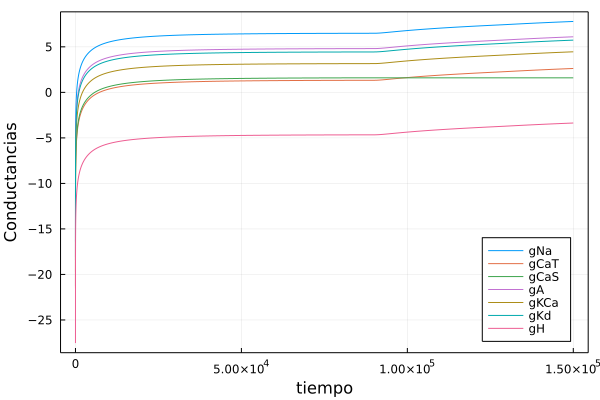

In [70]:
plot(t[1:100:1500000],log.(gna_3[1:100:1500000]),label="gNa",xlabel="tiempo",ylabel="Conductancias",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcat_3[1:100:1500000]),label="gCaT",legend=:bottomright)
plot!(t[1:100:1500000],log.(gcas_3[1:100:1500000]),label="gCaS",legend=:bottomright)
plot!(t[1:100:1500000],log.(ga_3[1:100:1500000]),label="gA",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkca_3[1:100:1500000]),label="gKCa",legend=:bottomright)
plot!(t[1:100:1500000],log.(gkd_3[1:100:1500000]),label="gKd",legend=:bottomright)
plot!(t[1:100:1500000],log.(gh_3[1:100:1500000]),label="gH",legend=:bottomright)
#savefig("Conductancias_tonic_gcas")

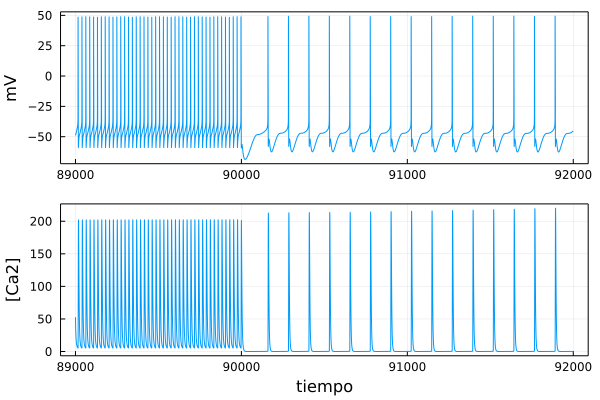

In [71]:
p111=plot(t[890000:920000],v_3[890000:920000],legend=false,ylabel="mV")
p222=plot(t[890000:920000],Ca2_3[890000:920000],legend=false,ylabel="[Ca2]",xlabel="tiempo")
plot(p111,p222,layout=(2,1))
#savefig("tonicgcas_doble")